In [1]:
import matplotlib.pyplot as plt
# from matplotlib.patches import Rectangle
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.ticker as mticker

import scipy
import numpy as np

from utils import ImageLoader,FPMReconstruction

%load_ext autoreload
%autoreload 2

# Preview Image


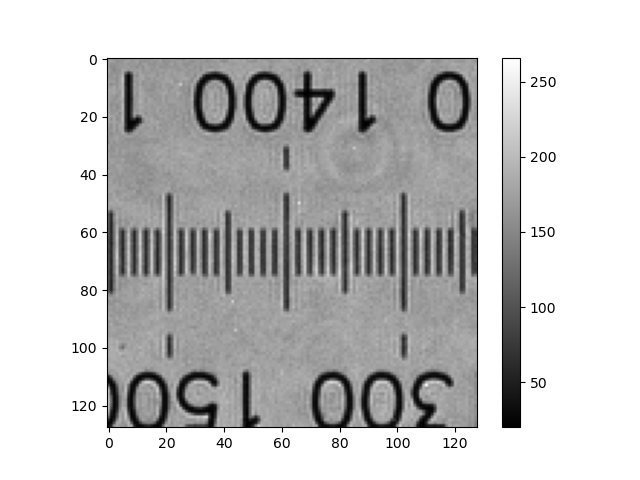

In [2]:
%matplotlib widget
plt.close()

# Chai Experiment Parameters
NA = 0.10
upsampRatio = 4             # upsampling ratio

# =======================================================================

# 7x7 Dot Matrix

# mag = 1.95
# pixelSize = 4.8e-6/mag          # low-res pixel size of the camera sensor
# N = 49
# LEDsize = 7            # size of the LED array (assumed to be odd)
# LEDgap = 4.0              # distance between LED elements (in mm)
# wavelength = 0.65e-6

# Malaria
# start = 9
# basePath = "../Dataset/7x7 Dot Matrix/Malaria (45mm)"
# bitDepth = 10
# slideHeight = 1.06
# LEDheight = 43.3+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0

# Malaria
# start = 6
# basePath = "../Dataset/7x7 Dot Matrix/Malaria (60mm)"
# bitDepth = 10
# slideHeight = 1.06
# LEDheight = 56.58+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0

# Malaria
# start = 6
# basePath = "../Dataset/7x7 Dot Matrix/Malaria (80mm)"
# bitDepth = 10
# slideHeight = 1.06
# LEDheight = 78.64+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0

# Malaria
# start = 1
# basePath = "../Dataset/7x7 Dot Matrix/Malaria"
# bitDepth = 10
# slideHeight = 1.06
# LEDheight = 78.92+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0

# Slanted Edge
# start = 0
# basePath = "../Dataset/7x7 Dot Matrix/Slanted Edge"
# # basePath = "../Dataset/Slanted Edge 10bit"
# bitDepth = 10
# slideHeight = 1.57
# LEDheight = 78.92+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0       # Defocus distance

# Micrometer 8bit
# start = 1
# # basePath = "../Dataset/7x7 Dot Matrix/Micrometer Dataset 8bit"
# basePath = "../Dataset/7x7 Dot Matrix/Micrometer"
# bitDepth = 10
# slideHeight = 1.57
# LEDheight = 78.92+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0


# =======================================================================

# 7x7 Panel Matrix

mag = 1.91
pixelSize = 4.8e-6/mag          # low-res pixel size of the camera sensor
N = 49
LEDsize = 7  # size of the LED array (assumed to be odd)
LEDgap = 2.0  # distance between LED elements (in mm)

#  Malaria 
# bitDepth = 10
# slideHeight = 1.06
# LEDheight = 37.31+slideHeight  # vertical distance between LED array and specimen (in mm)

# R
# start = 7
# basePath = "../Dataset/7x7 Panel Matrix/Malaria/R"
# wavelength = 0.627e-6

# G
# start = 4
# basePath = "../Dataset/7x7 Panel Matrix/Malaria/G"
# wavelength = 0.523e-6

# B
# start = 4
# basePath = "../Dataset/7x7 Panel Matrix/Malaria/B"
# wavelength = 0.467e-6

# Squares
# start = 2
# basePath = "../Dataset/7x7 Panel Matrix/Squares"
# bitDepth = 10
# slideHeight = 1.57
# wavelength = 0.627e-6
# LEDheight = 37.04+slideHeight  # vertical distance between LED array and specimen (in mm)

# Micrometer
start = 5
basePath = "../Dataset/7x7 Panel Matrix/Micrometer"
bitDepth = 10
slideHeight = 1.57
wavelength = 0.627e-6
LEDheight = 37.04+slideHeight  # vertical distance between LED array and specimen (in mm)
z=2.2e-6

# Slanted Edge
# start = 16
# basePath = "../Dataset/7x7 Panel Matrix/Slanted Edge 15x15"
# bitDepth = 10
# slideHeight = 1.57
# wavelength = 0.627e-6
# LEDheight = 38.05+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0

# =======================================================================

# 15x15 Panel Matrix

# mag = 1.95
# pixelSize = 4.8e-6/mag          # low-res pixel size of the camera sensor
# N = 225
# LEDsize = 15  # size of the LED array (assumed to be odd)
# LEDgap = 2.0  # distance between LED elements (in mm)

# Slanted Edge
# start = 4
# basePath = "../Dataset/15x15 Panel Matrix/Slanted Edge"
# bitDepth = 10
# slideHeight = 1.57
# wavelength = 0.627e-6
# LEDheight = 65.16+slideHeight  # vertical distance between LED array and specimen (in mm)

# Micrometer
# start = 4
# basePath = "../Dataset/15x15 Panel Matrix/Micrometer"
# bitDepth = 10
# slideHeight = 1.57
# wavelength = 0.627e-6
# LEDheight = 65.1+slideHeight  # vertical distance between LED array and specimen (in mm)
# z=0

# Malaria
# N = 121
# LEDsize = 11  # size of the LED array (assumed to be odd)
# slideHeight = 1.28
# LEDheight = 65.15+slideHeight  # vertical distance between LED array and specimen (in mm)
# bitDepth = 10

# R 
# start = 1
# basePath = "../Dataset/15x15 Panel Matrix/Malaria/R"
# start = 3
# basePath = "../Dataset/15x15 Panel Matrix/Malaria (Misaligned)/R"
# wavelength = 0.627e-6

# G 
# start = 1
# basePath = "../Dataset/15x15 Panel Matrix/Malaria/G"
# start = 3
# basePath = "../Dataset/15x15 Panel Matrix/Malaria (Misaligned)/G"
# wavelength = 0.523e-6

# B
# start = 1
# basePath = "../Dataset/15x15 Panel Matrix/Malaria/B"
# start = 2
# basePath = "../Dataset/15x15 Panel Matrix/Malaria (Misaligned)/B"
# wavelength = 0.467e-6

# =======================================================================

# Generate filenames programmatically
imageFNs = [basePath + "/" +
            ('0'*(4-len(str(i+start))) + str(i+start) + '.tiff') for i in range(N)]

# Initialize image loader
# Loader = ImageLoader(imageFNs[0], 1024)
Loader = ImageLoader(imageFNs[0], 128)
# Loader = ImageLoader(imageFNs[0], 64)

# Square
# Loader = ImageLoader(imageFNs[0], 64, ROI=(550, 577))     # dot matrix slanted edge
# Loader = ImageLoader(imageFNs[0], 64, ROI=(510, 575))

sampleImg = Loader.load_image(imageFNs[0])

images = Loader.load_all_images(imageFNs)

plt.imshow(sampleImg, cmap='gray')
plt.colorbar()
plt.show()

# Guoan Zheng Bloodsmear Dataset


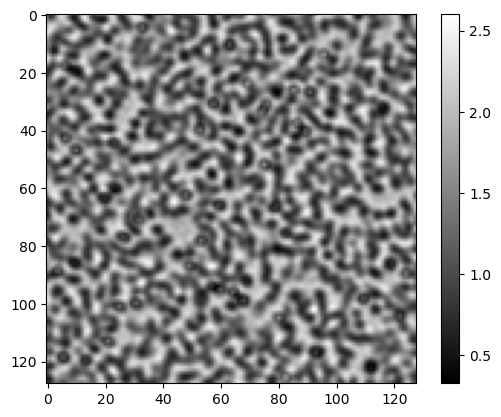

In [7]:
%matplotlib inline
plt.close()
# Load the .mat file containing the MATLAB array
mat_data = scipy.io.loadmat("bloodsmear_red.mat")
# mat_data = scipy.io.loadmat('HE_red.mat')

mat_array = mat_data["imlow_HDR"]
images = np.array(mat_array)

plt.imshow(images[:, :, 0], cmap="gray")
plt.colorbar()
plt.show()

# Bloodsmear Parameters
LEDsize = 15  # size of the LED array (assumed to be odd)
LEDgap = 4.0  # distance between LED elements (in mm)
LEDheight = 90.88  # vertical distance between LED array and specimen (in mm)
NA = 0.10
wavelength = 0.630e-6  # 630nm LED light
# wavelength = 0.475e-6  # 630nm LED light
upsampRatio = 4  # upsampling ratio
pixelSize = 1.845e-6
z = -55.0e-6        # Defocus aberrration
bitDepth = 8

# Basic Reconstruction


In [3]:
# %load_ext line_profiler

# %lprun -f FPM.reconstruct FPM.reconstruct(5,"Basic Reconstruction",save=False)

1276272.0155208535
997331.0011396168


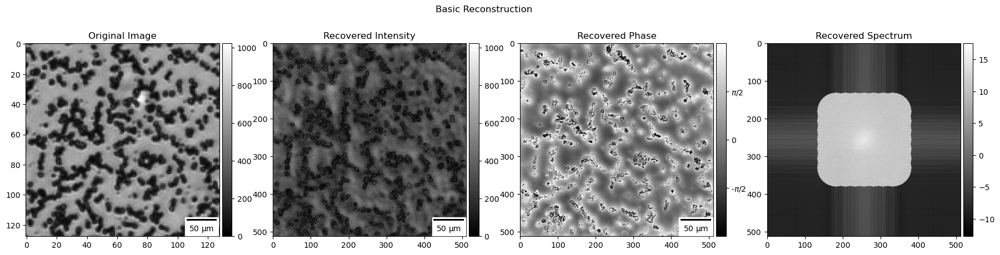

In [16]:
%matplotlib inline
plt.close()
FPM = FPMReconstruction(images[:,:,:],bitDepth,NA,LEDsize,LEDgap,LEDheight,0,wavelength,upsampRatio,pixelSize)
reconstructionImage,reconstructionFT,pupil,convergence = FPM.reconstruct(5,"Basic Reconstruction",save=False,method='Basic')

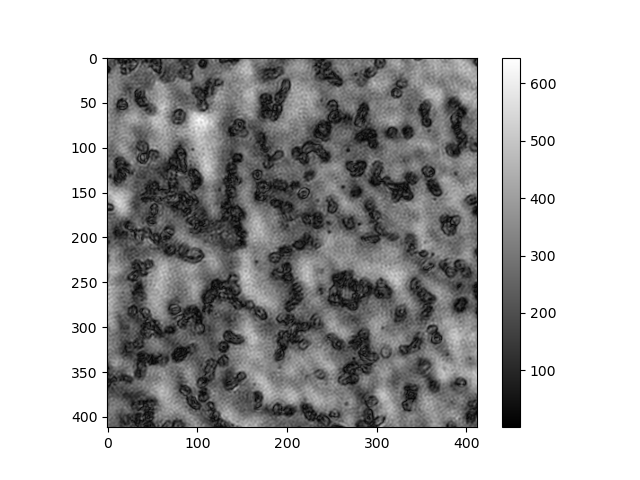

In [17]:
%matplotlib widget
plt.close()
hires = np.abs(reconstructionImage)
# Threshold
# hires[hires >255] = 255

plt.imshow(hires[50:-50,50:-50],cmap='gray')
plt.colorbar()
plt.show()

# EPRY Reconstruction


1250092.0767409385
1002102.9198053568


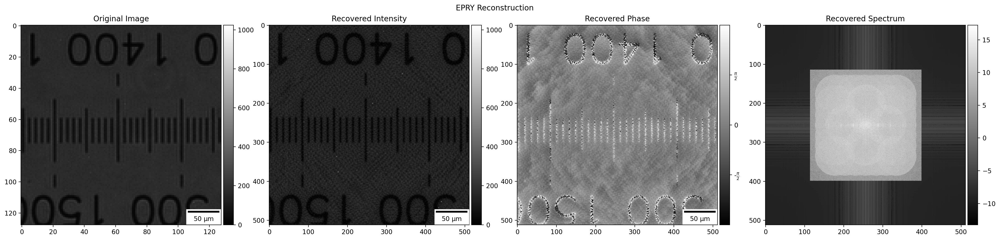

In [4]:
%matplotlib inline
plt.close()
FPM = FPMReconstruction(images[:,:,:],bitDepth,NA,LEDsize,LEDgap,LEDheight,z,wavelength,upsampRatio,pixelSize,apodized=False,sigma=128*0.33)
reconstructionImage,reconstructionFT,pupil,convergence = FPM.reconstruct(5,"EPRY Reconstruction",save=False,method='EPRY')

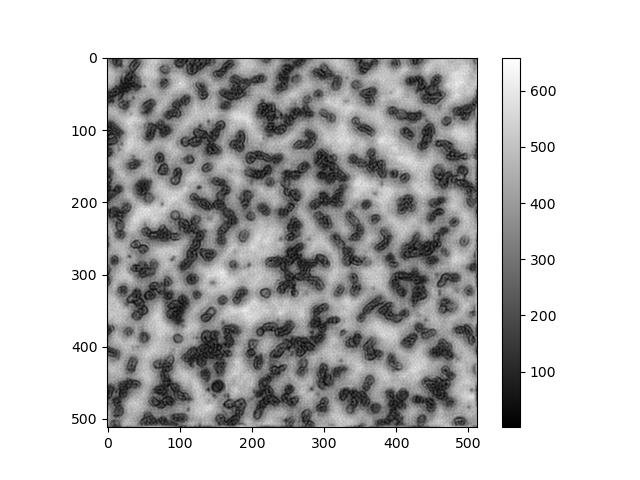

In [17]:
%matplotlib widget
plt.close()
hires = np.abs(reconstructionImage)
# hires = np.abs(reconstructionFT)
# Threshold
# hires[hires >255] = 255

# plt.imshow(hires,cmap='jet')
plt.imshow(hires,cmap='gray')
# plt.imshow(hires,cmap='gray',vmin=0,vmax=1024)
# plt.imshow(hires[20:-20,20:-20],cmap='gray')
plt.colorbar()
plt.show()

In [23]:
np.save("./Results temp/slanted Reconstruction(Panel Matrix)", hires)

# import tifffile
# tifffile.imwrite("./Results temp/Malaria_hires.tiff", hires.astype("uint16"))

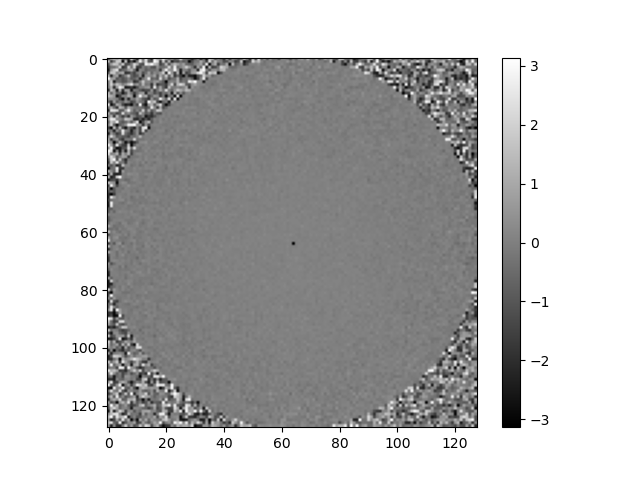

In [37]:
%matplotlib widget
plt.close()
# plt.imshow(np.abs(pupil), cmap='gray')
plt.imshow(np.angle(pupil), cmap='gray')
plt.colorbar()

# Offset Testing


c:\Users\Nic\Documents\MEGA\3-Academia\2-College\VIP\FPM Research\Phase 1_FPM Basics\utils.py:115: RuntimeWarning: divide by zero encountered in divide
  gaussian = np.exp(-((x**2 / (2 * sigma**2)) + (y**2 / (2 * sigma**2))))
c:\Users\Nic\Documents\MEGA\3-Academia\2-College\VIP\FPM Research\Phase 1_FPM Basics\utils.py:115: RuntimeWarning: invalid value encountered in divide
  gaussian = np.exp(-((x**2 / (2 * sigma**2)) + (y**2 / (2 * sigma**2))))
c:\Users\Nic\Documents\MEGA\3-Academia\2-College\VIP\FPM Research\Phase 1_FPM Basics\utils.py:259: RuntimeWarning: invalid value encountered in divide
  np.max(np.abs(self.pupil) ** 2)
c:\Users\Nic\Documents\MEGA\3-Academia\2-College\VIP\FPM Research\Phase 1_FPM Basics\utils.py:265: RuntimeWarning: invalid value encountered in divide
  / (np.max(np.abs(objectRecoverFT[kyl:kyh, kxl:kxh]) ** 2))


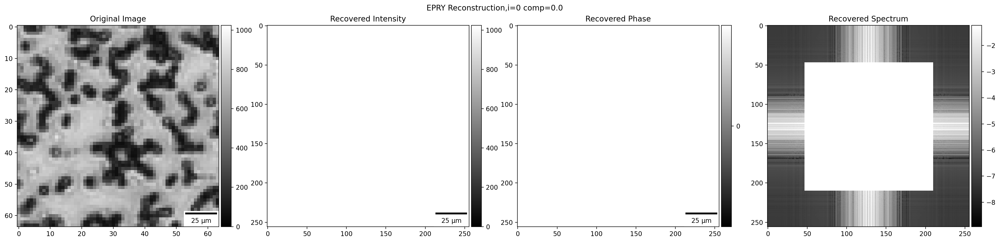

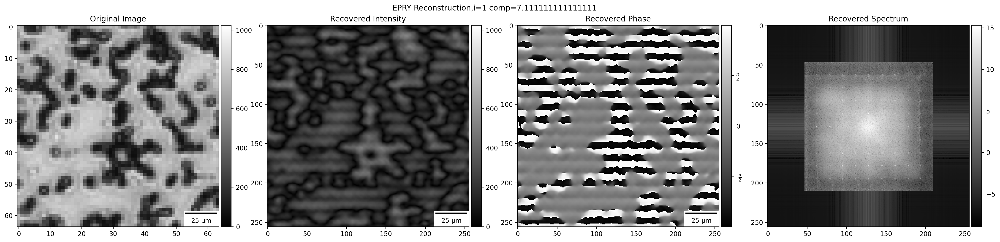

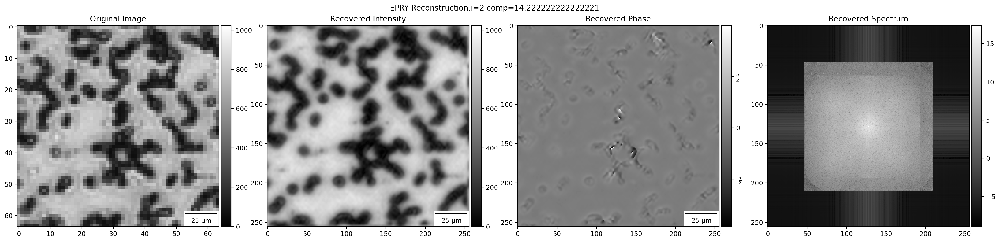

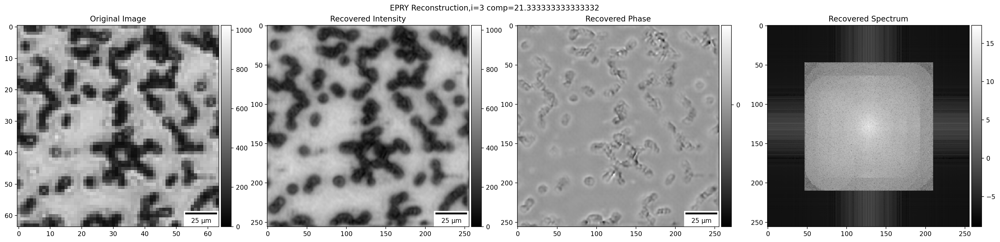

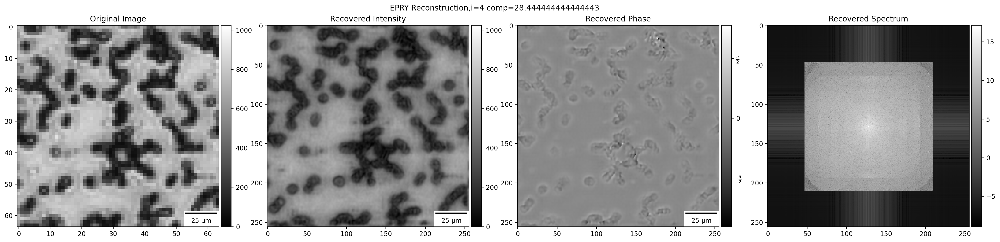

...

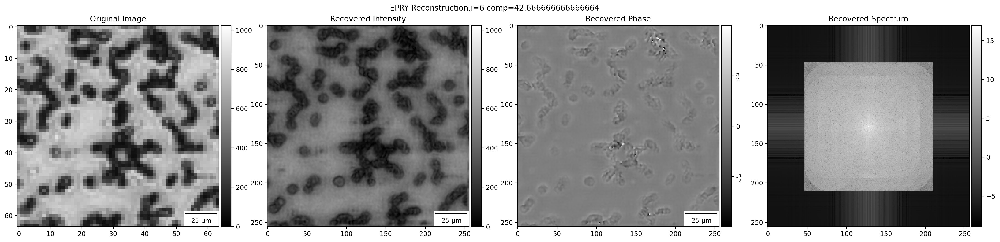

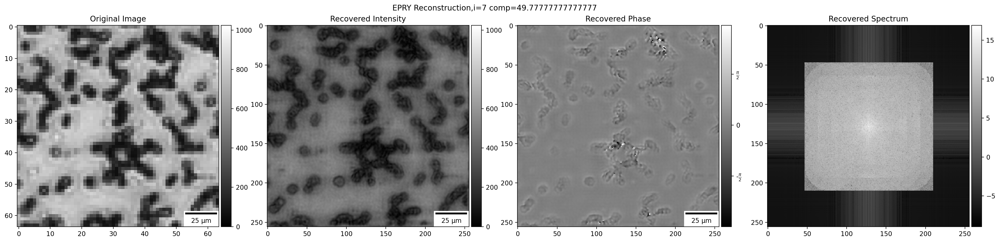

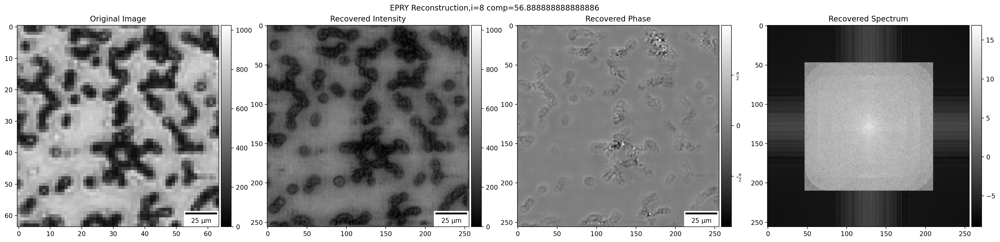

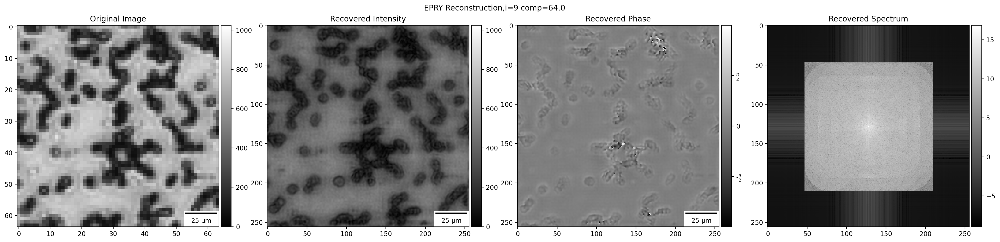

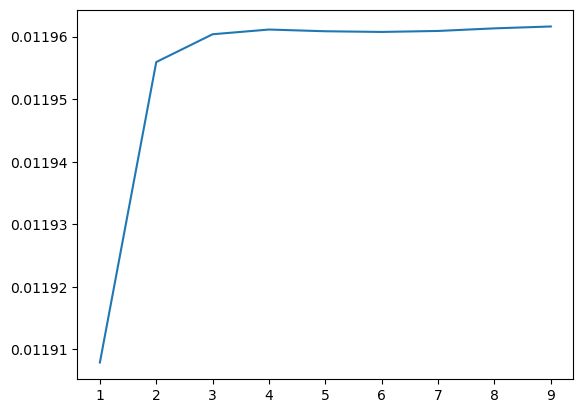

In [29]:
%matplotlib inline
plt.close()
nums = 10
comps = np.linspace(0, 64, nums)    # Apodization
# comps = np.arange(42,52)    # Apodization
# comps = np.linspace(-1, 1, nums) * 2    # LED height
# comps = np.linspace(-1, 1, nums) * 20e-6  # Defocus aberration
# comps = np.linspace(1, 3, nums) * 20e-6
convIndex = np.zeros(nums)
for i,comp in enumerate(comps):
    FPM = FPMReconstruction(
        images[:, :, :],
        bitDepth,
        NA,
        LEDsize,
        LEDgap,
        LEDheight,
        0,
        wavelength,
        upsampRatio,
        pixelSize,
        apodized=True,
        sigma=comp
    )
    
    reconstructionImage, reconstructionFT,pupil,convergence = FPM.reconstruct(
        5, f"EPRY Reconstruction,i={i} comp={comp}",save=False,method='EPRY'
    )
    convIndex[i] = convergence[-1]

plt.plot(np.arange(nums),convIndex)

# Fourier Recovery Animation


Animation size has reached 21009997 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


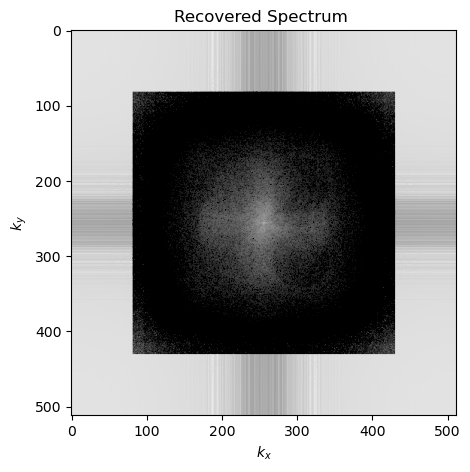

In [15]:
%matplotlib inline
ani = FPM.animate(interval=3)
ani

In [17]:
ani.save("bloodsmear spectrum.gif", writer="pillow")

# Detailed closeup


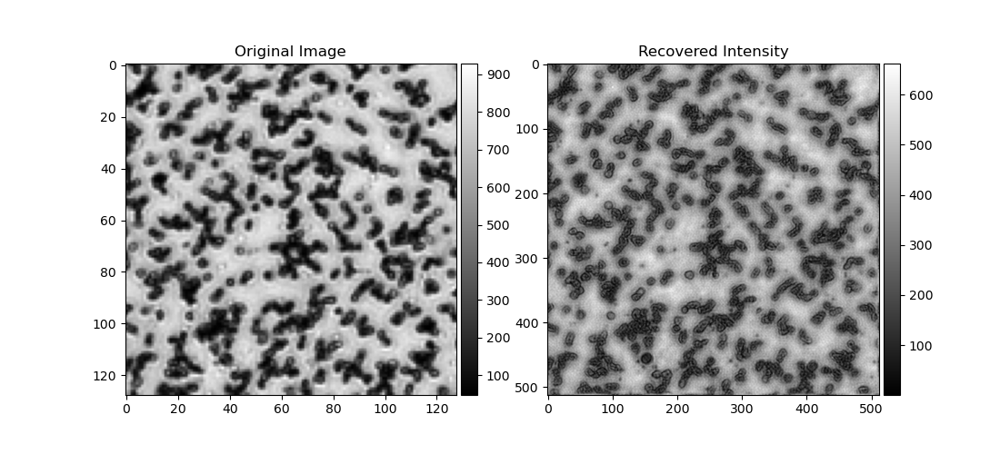

In [34]:
%matplotlib widget
plt.close()
fig, axs = plt.subplots(1, 2, figsize=(11, 5))

x = 170
y = 40

im0 = axs[0].imshow(sampleImg, cmap='gray')
# im0 = axs[0].imshow(sampleImg, cmap='gray', vmax=300)
# im0 = axs[0].imshow(sampleImg[x:x+50, y:y+50], cmap='gray')
axs[0].set_title('Original Image')

divider = make_axes_locatable(axs[0])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im0, cax=cax, orientation='vertical')

im1 = axs[1].imshow(np.abs(reconstructionImage), cmap='gray')
# im1 = axs[1].imshow(np.abs(reconstructionImage), cmap='gray',vmax=300)
# im1 = axs[1].imshow(np.abs(reconstructionImage)[x*4:(x+50)*4, y*4:(y+50)*4], cmap='gray')
axs[1].set_title('Recovered Intensity')

divider = make_axes_locatable(axs[1])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')

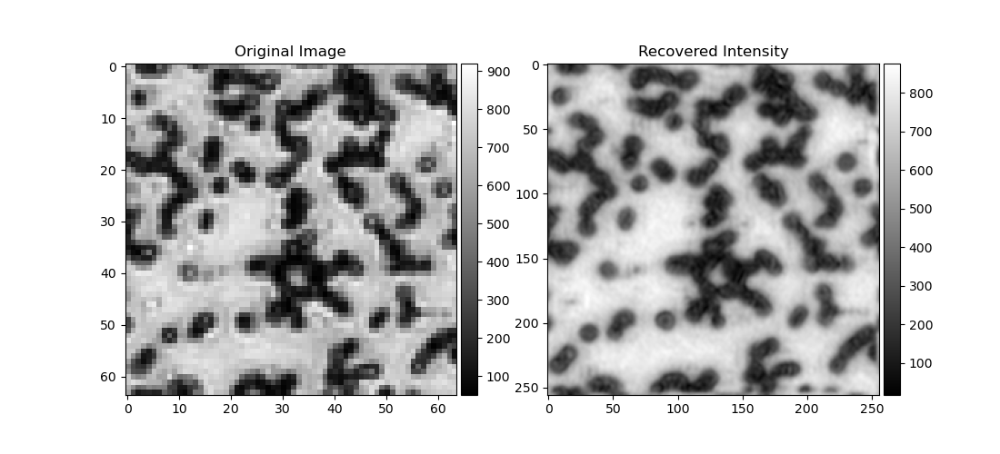

In [31]:
%matplotlib widget
plt.close()
fig, axs = plt.subplots(1, 2, figsize=(11, 5))

x = 170
y = 40

im0 = axs[0].imshow(sampleImg, cmap='gray')
# im0 = axs[0].imshow(sampleImg, cmap='gray', vmax=300)
# im0 = axs[0].imshow(sampleImg[x:x+50, y:y+50], cmap='gray')
axs[0].set_title('Original Image')

divider = make_axes_locatable(axs[0])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im0, cax=cax, orientation='vertical')

im1 = axs[1].imshow(np.abs(reconstructionImage), cmap='gray')
# im1 = axs[1].imshow(np.abs(reconstructionImage), cmap='gray',vmax=300)
# im1 = axs[1].imshow(np.abs(reconstructionImage)[x*4:(x+50)*4, y*4:(y+50)*4], cmap='gray')
axs[1].set_title('Recovered Intensity')

divider = make_axes_locatable(axs[1])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(im1, cax=cax, orientation='vertical')